In [22]:
# 一些库
import IPython
import librosa
import librosa.display as dsp
import matplotlib.pyplot as plt
import numpy as np
from scipy.io import wavfile
%matplotlib inline  

In [14]:
# 生成短时间音频
sr = 16000
# wav = np.zeros(int(16000*1*0.480))
wavfile.write("test1.wav", sr, wav.astype(np.int16))

In [24]:
# 显示wav文件
IPython.display.Audio('test.wav')

In [ ]:
# 同一张图显示三个音频图像
sr = 16000
wav_origin = librosa.core.load('origin.wav', sr=sr)[0]
wav_liner = librosa.core.load('liner.wav', sr=sr)[0]
wav_mel = librosa.core.load('mel.wav', sr=sr)[0]

plt.figure(figsize=(18,8))

ax = plt.subplot(3, 1, 1)
dsp.waveplot(wav_origin, sr=sr)
ax.set_title('origin waveform')
ax = plt.subplot(3, 1, 2,sharex=ax)
dsp.waveplot(wav_liner, sr=sr)
ax.set_title('liner waveform')
ax = plt.subplot(3, 1, 3,sharex=ax)
dsp.waveplot(wav_mel, sr=sr)
ax.set_title('mel waveform')

In [25]:
# 生成mel谱
wav = librosa.core.load('test.wav', sr=sr)[0]
n_fft = 1024
hop_size=200
win_length=800

n_mels = 80
fmin = 55
fmax = 7600

min_level_db = -100
max_abs_value = 4
ref_level_db = 20

D = librosa.stft(y=wav, n_fft=n_fft, hop_length=hop_size, win_length=win_length)
D = np.abs(D)
mel_basis = librosa.filters.mel(sr, n_fft, n_mels=n_mels,fmin=fmin, fmax=fmax)
D = np.dot(mel_basis, D)
min_level = np.exp(min_level_db / 20 * np.log(10))
D = 20 * np.log10(np.maximum(min_level, D))
Smel = D - ref_level_db

# S = np.clip((2 * max_abs_value) * ((S - min_level_db) / (-min_level_db)) - max_abs_value, max_abs_value, max_abs_value)
# S = np.clip((2 * max_abs_value) * ((S - min_level_db) / (-min_level_db)) - max_abs_value, -max_abs_value, max_abs_value)

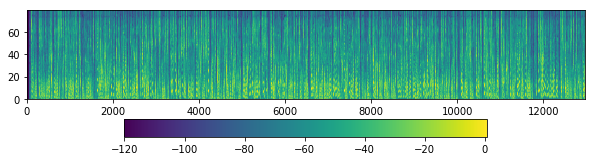

In [26]:
#mel谱画图
fig = plt.figure(figsize=(10, 8))
ax1 = fig.add_subplot(311)
im = ax1.imshow(Smel, aspect='auto', interpolation='none')
ax1.invert_yaxis() 
fig.colorbar(mappable=im, shrink=0.65, orientation='horizontal', ax=ax1)

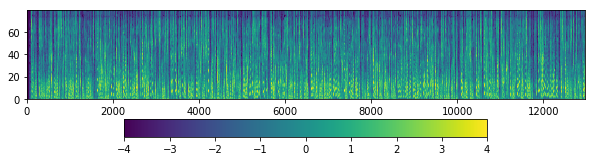

In [27]:
# mel谱正则化以后画图
Smel_n = np.clip((2 * max_abs_value) * ((Smel - min_level_db) / (-min_level_db)) - max_abs_value, -max_abs_value, max_abs_value)
fig = plt.figure(figsize=(10, 8))
ax1 = fig.add_subplot(311)
im = ax1.imshow(Smel_n, aspect='auto', interpolation='none')
ax1.invert_yaxis() 
fig.colorbar(mappable=im, shrink=0.65, orientation='horizontal', ax=ax1)

In [28]:
# 生成直线谱
D = librosa.stft(y=wav, n_fft=n_fft, hop_length=hop_size, win_length=win_length)
D = np.abs(D)

min_level = np.exp(min_level_db / 20 * np.log(10))
D = 20 * np.log10(np.maximum(min_level, D))
S_line = D - ref_level_db

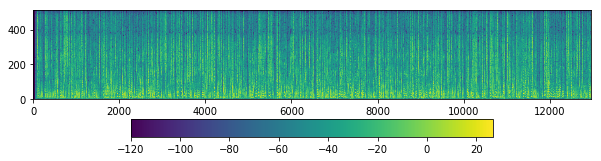

In [29]:
# 直线谱画图
fig = plt.figure(figsize=(10, 8))
ax1 = fig.add_subplot(311)
im = ax1.imshow(S_line, aspect='auto', interpolation='none')
ax1.invert_yaxis() 
fig.colorbar(mappable=im, shrink=0.65, orientation='horizontal', ax=ax1)

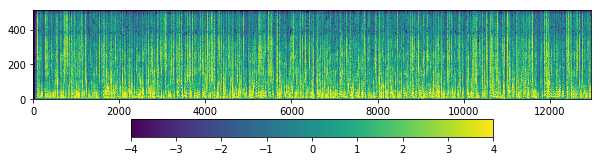

In [30]:
#直线谱正则以后画图
S_line_n = np.clip((2 * max_abs_value) * ((S_line - min_level_db) / (-min_level_db)) - max_abs_value, -max_abs_value, max_abs_value)
fig = plt.figure(figsize=(10, 8))
ax1 = fig.add_subplot(311)
im = ax1.imshow(S_line_n, aspect='auto', interpolation='none')
ax1.invert_yaxis() 
fig.colorbar(mappable=im, shrink=0.65, orientation='horizontal', ax=ax1)

In [ ]:
# 直线谱转换成声音
power = 1.5
griffin_lim_iters = 60

def _stft(y):
    return librosa.stft(y=y, n_fft=n_fft, hop_length=hop_size, win_length=win_length)

def _istft(y):
    return librosa.istft(y, hop_length=hop_size, win_length=win_length)

def _griffin_lim(S):
    '''librosa implementation of Griffin-Lim
    Based on https://github.com/librosa/librosa/issues/434
    '''
    angles = np.exp(2j * np.pi * np.random.rand(*S.shape))
    S_complex = np.abs(S).astype(np.complex)
    y = _istft(S_complex * angles)
    for i in range(griffin_lim_iters):
        angles = np.exp(1j * np.angle(_stft(y)))
    return y
    

D = (((np.clip(S_line_n, -max_abs_value,max_abs_value) + max_abs_value) * -min_level_db / (2 * max_abs_value))+ min_level_db)
D = D + ref_level_db
S = np.power(10.0, (D) * 0.05)

wav = _griffin_lim(S ** power)

wav *= 32767 / max(0.01, np.max(np.abs(wav)))
wavfile.write("liner2wav.wav", sr, wav.astype(np.int16))

/Users/liuxinxin/anaconda3/lib/python3.6/site-packages/librosa/util/utils.py:1725: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if np.issubdtype(x.dtype, float) or np.issubdtype(x.dtype, complex):


In [ ]:
# mel谱转换成声音
D = (((np.clip(Smel_n, -max_abs_value,max_abs_value) + max_abs_value) * -min_level_db / (2 * max_abs_value))+ min_level_db)
D = D + ref_level_db
S = np.power(10.0, (D) * 0.05)
_inv_mel_basis = np.linalg.pinv(librosa.filters.mel(sr, n_fft, n_mels=n_mels,fmin=fmin, fmax=fmax))
S = np.maximum(1e-10, np.dot(_inv_mel_basis, S))

wav = _griffin_lim(S ** power)

wav *= 32767 / max(0.01, np.max(np.abs(wav)))
wavfile.write("mel2wav.wav", sr, wav.astype(np.int16))

In [4]:
# 合并声音
wav_1 = librosa.core.load('1.wav', sr=16000)[0]
wav_2 = librosa.core.load('2.wav', sr=16000)[0]
wav_3 = np.concatenate((wav_1,wav_2),axis=0)
wavfile.write("3.wav", 16000, wav_3)

In [2]:
# MP3 2 WAV
from pydub import AudioSegment
 
def trans_mp3_to_wav(filepath,new_name="new"):
    song = AudioSegment.from_mp3(filepath)
    song.export("{}.wav".format(new_name), format="wav")
    
trans_mp3_to_wav("1.mp3",new_name="new")

In [13]:
# 声音切片 18s 到 180秒
sound1 = AudioSegment.from_file("new.wav", format="wav")
beginning = sound1[18000:78000]
beginning.export("test1.wav",format="wav")

<_io.BufferedRandom name='test1.wav'>

In [33]:
# 声音放慢
import librosa
from scipy.io import wavfile
import numpy as np
y, sr   = librosa.core.load('test1.wav', sr=16000)
D       = librosa.stft(y, n_fft=1024, hop_length=200)
D_slow  = librosa.phase_vocoder(D, 0.5, hop_length=200)
y_slow  = librosa.istft(D_slow, hop_length=200)
wavfile.write("test2.wav", 16000, y_slow)

/Users/liuxinxin/anaconda3/lib/python3.6/site-packages/librosa/util/utils.py:1725: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  if np.issubdtype(x.dtype, float) or np.issubdtype(x.dtype, complex):
